In [19]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import chi2_contingency
import plotly.express as px
import seaborn as sns

# Load dataset
df = pd.read_csv('train.csv')  # Replace with your actual file path


In [20]:
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


## type of columns

In [21]:
for dtype in df.dtypes.unique():
    cols = df.select_dtypes(include=[dtype]).columns.tolist()
    print(f"{dtype}: {cols}")


int64: ['Id', 'MSSubClass', 'LotArea', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageCars', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'MiscVal', 'MoSold', 'YrSold', 'SalePrice']
object: ['MSZoning', 'Street', 'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual', 'Functional', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond', 'Paved

In [22]:
df[['MSSubClass', 'MoSold', 'YearBuilt', 'YearRemodAdd', 'YrSold']] = df[['MSSubClass', 'MoSold', 'YearBuilt', 'YearRemodAdd', 'YrSold']].astype('object')

## Missing values

Some missing values represent an absence (pool, fire place...)

In [4]:
# Check for columns with NaNs
missing_cols = df.columns[df.isna().any()]
print("Columns with missing values:")
print(missing_cols)

# Optional: see how many missing values per column
print("\nMissing value counts:")
print(df[missing_cols].isna().sum())

missing_percent = df.isna().mean() * 100
missing_percent = missing_percent[missing_percent > 0].sort_values(ascending=False)

print("Missing value percentage per column:")
print(missing_percent.round(2))

Columns with missing values:
Index(['LotFrontage', 'Alley', 'MasVnrType', 'MasVnrArea', 'BsmtQual',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2',
       'Electrical', 'FireplaceQu', 'GarageType', 'GarageYrBlt',
       'GarageFinish', 'GarageQual', 'GarageCond', 'PoolQC', 'Fence',
       'MiscFeature'],
      dtype='object')

Missing value counts:
LotFrontage      259
Alley           1369
MasVnrType       872
MasVnrArea         8
BsmtQual          37
BsmtCond          37
BsmtExposure      38
BsmtFinType1      37
BsmtFinType2      38
Electrical         1
FireplaceQu      690
GarageType        81
GarageYrBlt       81
GarageFinish      81
GarageQual        81
GarageCond        81
PoolQC          1453
Fence           1179
MiscFeature     1406
dtype: int64
Missing value percentage per column:
PoolQC          99.52
MiscFeature     96.30
Alley           93.77
Fence           80.75
MasVnrType      59.73
FireplaceQu     47.26
LotFrontage     17.74
GarageType       5.55
Garag

## Fill missing values

In [5]:
# Identify categorical columns
cat_cols = df.select_dtypes(include=['object', 'category']).columns

# Fill missing values with "Missing"
df[cat_cols] = df[cat_cols].fillna("Missing")

# Fil NA
#save numeric means for missing test
means = df.select_dtypes(include='number').mean()

#imputer numeric par moyenne dans train
df = df.fillna(df.select_dtypes(include='number').mean())

C:\Users\berra\AppData\Local\Temp\ipykernel_13880\2743285230.py:5: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df[cat_cols] = df[cat_cols].fillna("Missing")


## Distribution

Many skewed variables (LotFrontage, SalePrice..). Many variables have a many 0 values that represent the missing of a criteria

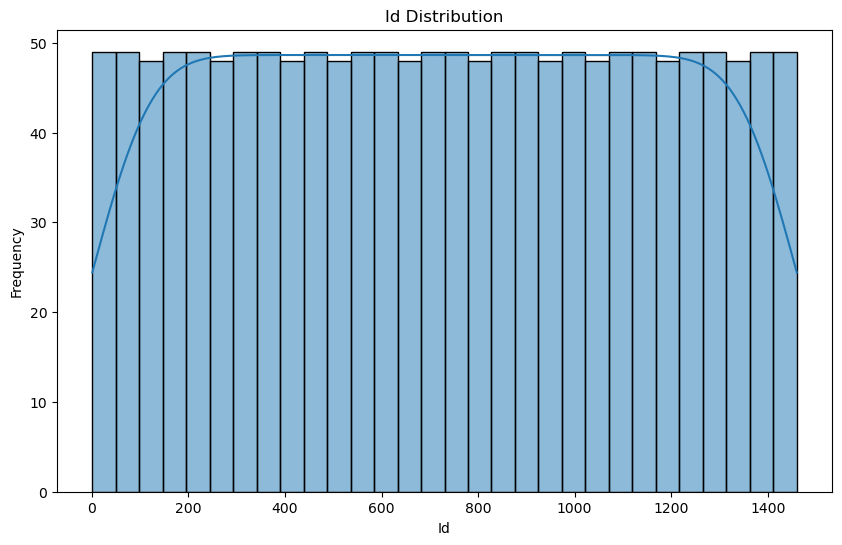

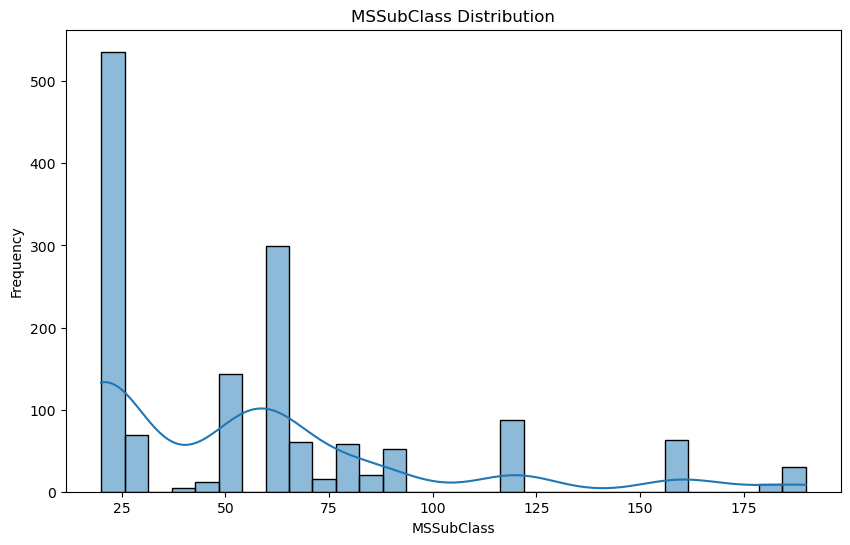

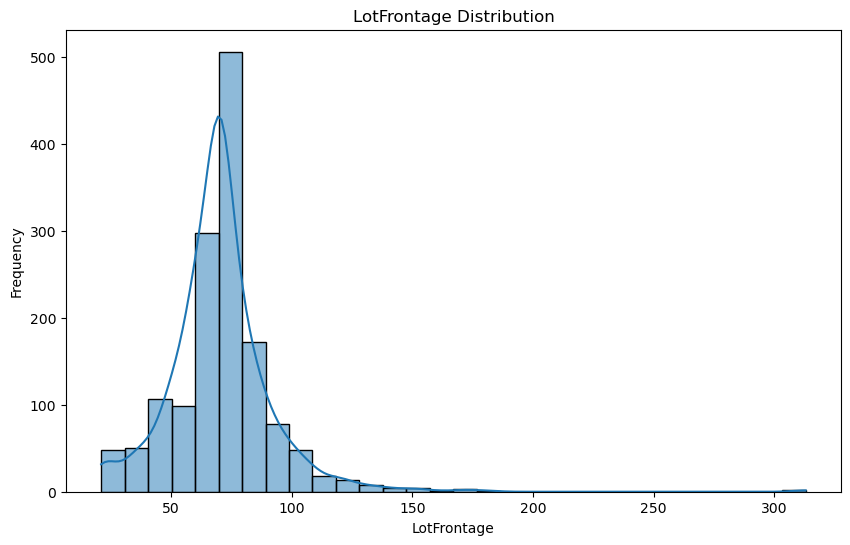

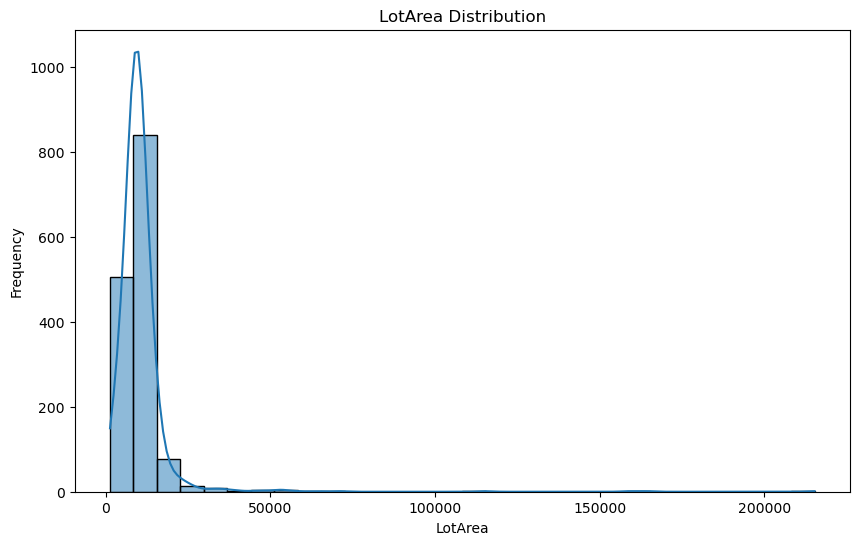

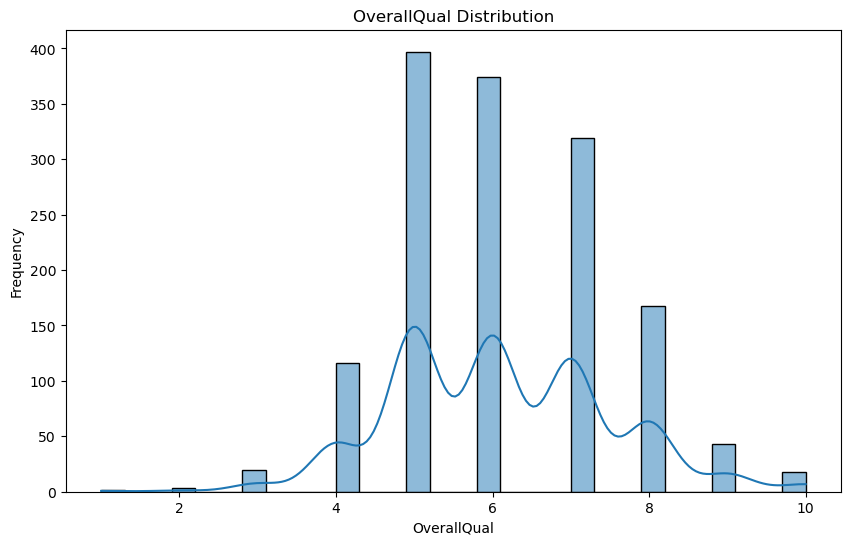

...

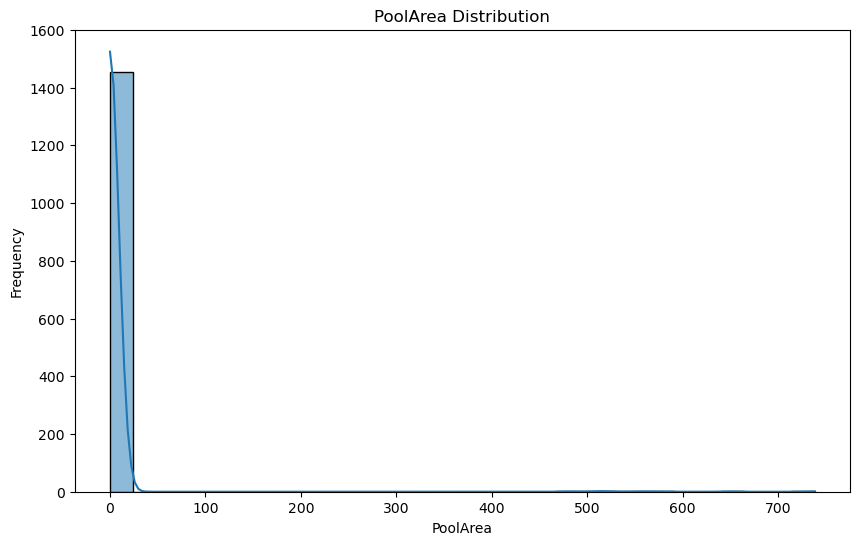

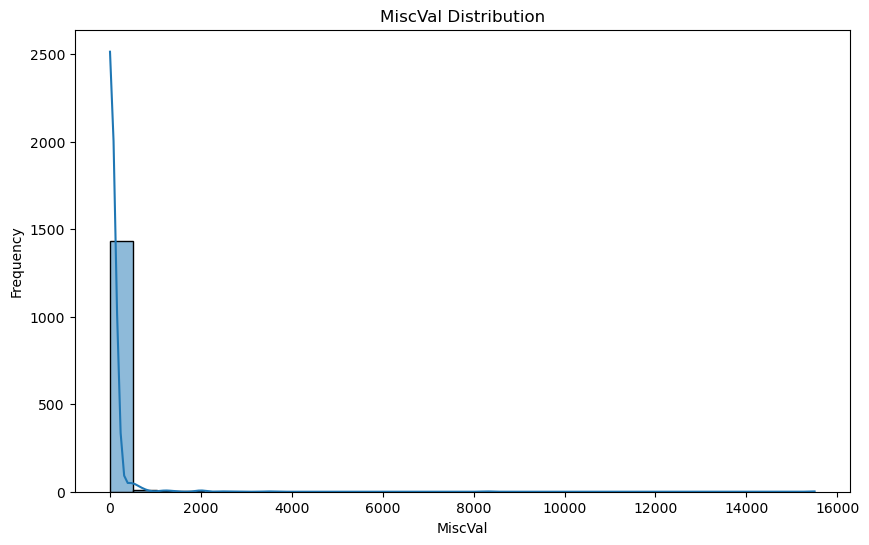

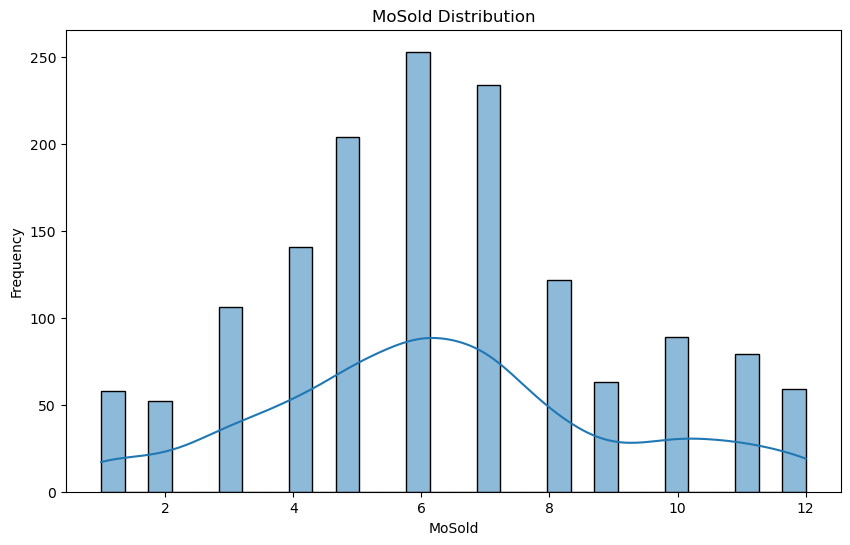

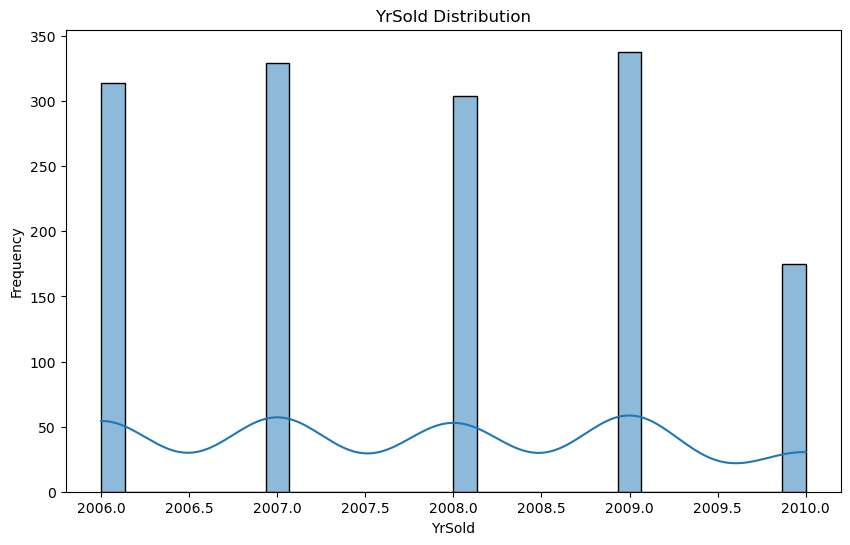

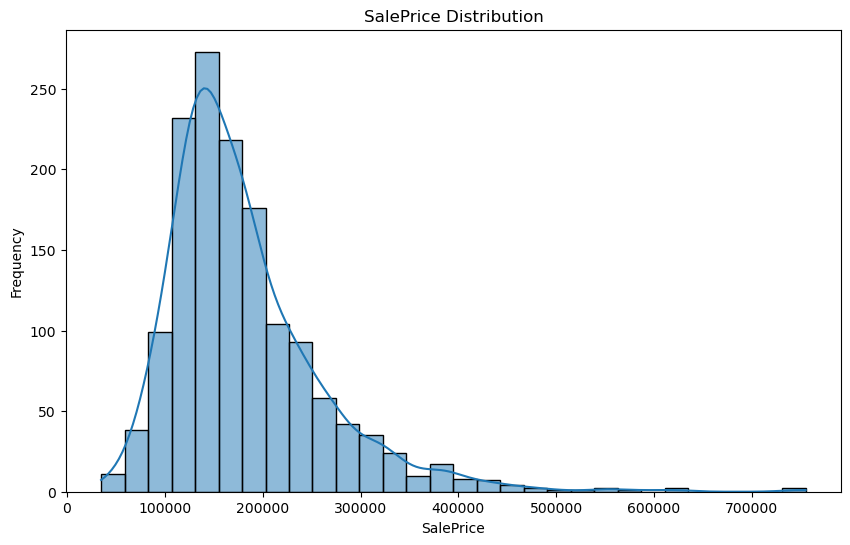

In [6]:
df = df.copy()
for col in df.select_dtypes(include=['number']).columns:
    plt.figure(figsize=(10, 6))
    sns.histplot(df[col], bins=30, kde=True)
    plt.title(f'{col} Distribution')
    plt.xlabel(col)
    plt.ylabel('Frequency')
    plt.show()

## Boxplots

Many categorical variables seem to have a correlation with the SalePrice

In [7]:
# Target variable
target_col = 'SalePrice'

# Select categorical columns
cat_cols = df.select_dtypes(include=['object']).columns

# Plot interactive boxplots
for col in cat_cols:
    fig = px.box(df, x=col, y=target_col, points='all', title=f"Boxplot of {target_col} by {col}")
    fig.update_layout(xaxis_tickangle=45)
    fig.show()

## Create variable (interpretability)

In [8]:
df = df.copy()

#'YearBuilt', 'YearRemodAdd, 'MoSold', 'YrSold' convert to quantitative
# List of columns to convert
columns_to_convert = ['YearBuilt', 'YearRemodAdd', 'MoSold', 'YrSold']

# Convert each to integer safely
for col in columns_to_convert:
    df.loc[:, col] = df[col].astype(int)

# Set reference year
reference_year = df['YrSold'].max()

# Create quantitative features safely
df.loc[:, 'HouseAge'] = reference_year - df['YearBuilt']
df.loc[:, 'YearsSinceRemod'] = reference_year -df['YearRemodAdd']
df.loc[:, 'TimeIndex'] = (
    (df['YrSold'] - df['YrSold'].min()) * 12 + df['MoSold']
)

df = df.drop([
    'YearBuilt', 'YearRemodAdd', 'YrSold', 'MoSold'
], axis=1) 

# Convert object columns to numeric, forcing errors to NaN
cols_to_convert = ['HouseAge', 'YearsSinceRemod', 'TimeIndex']
df[cols_to_convert] = df[cols_to_convert].apply(pd.to_numeric, errors='coerce')

## Outliers

Some variables have outliers that could impact negatively our models, especially the linear ones

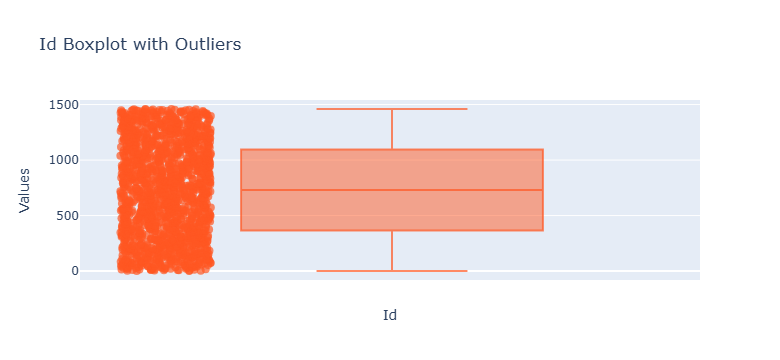

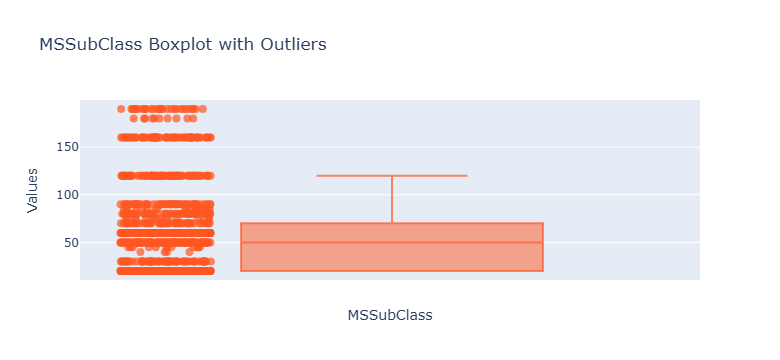

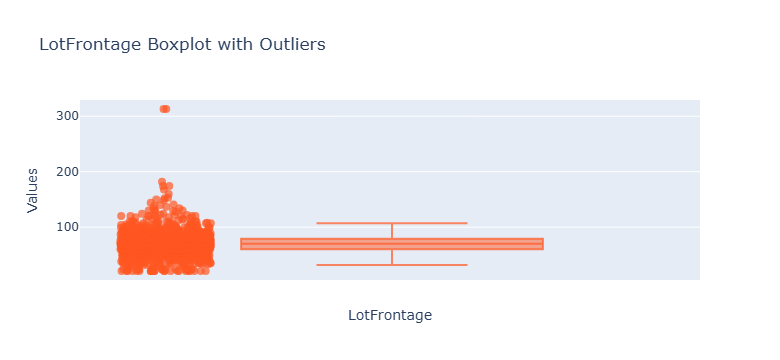

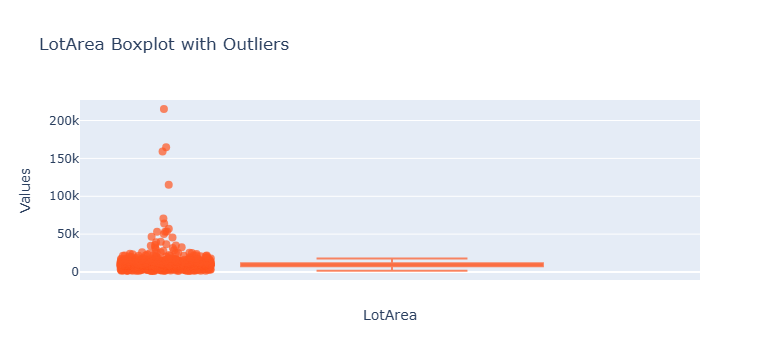

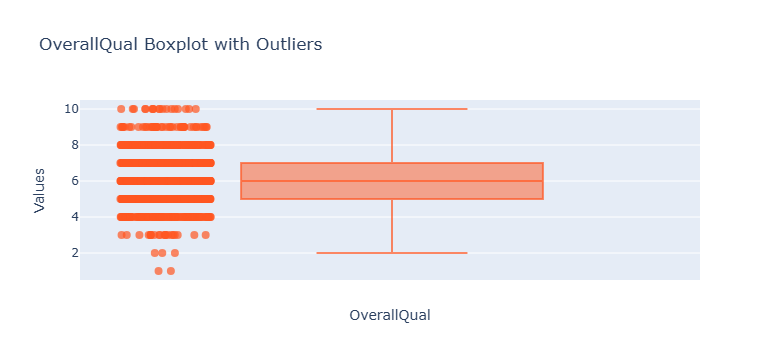

...

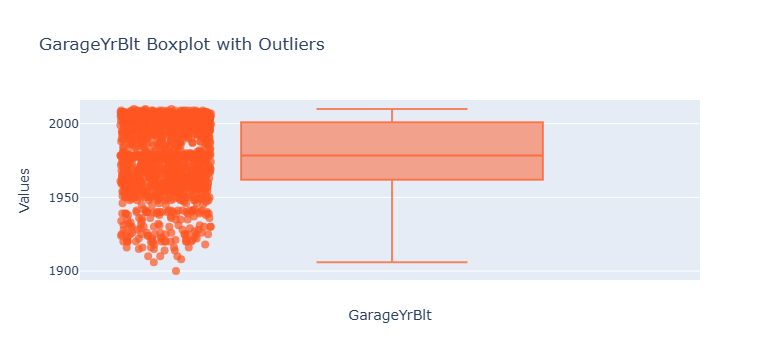

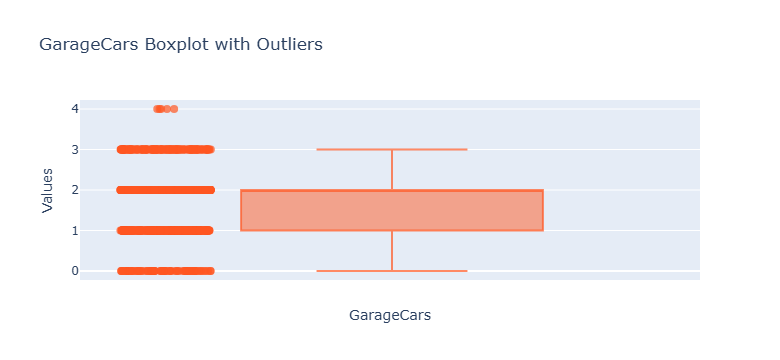

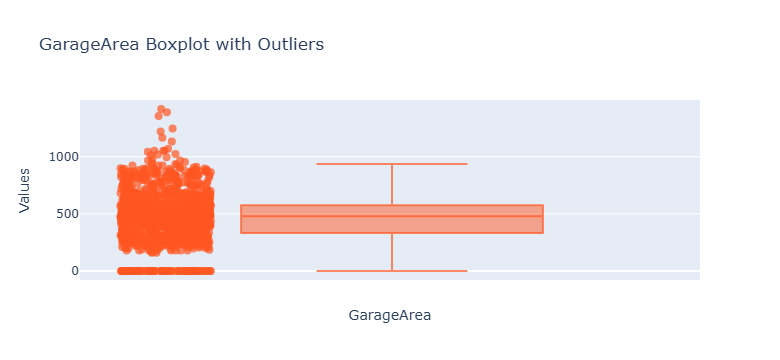

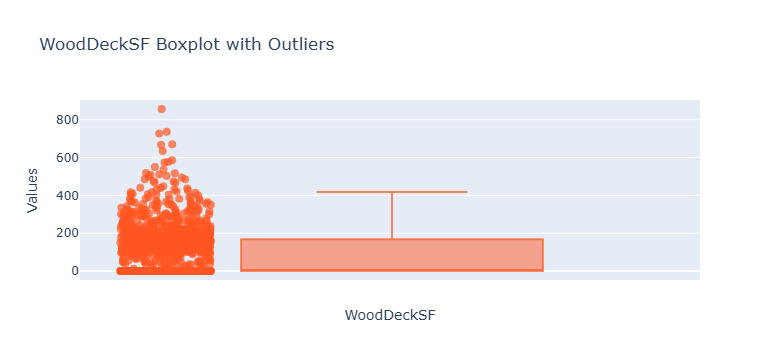

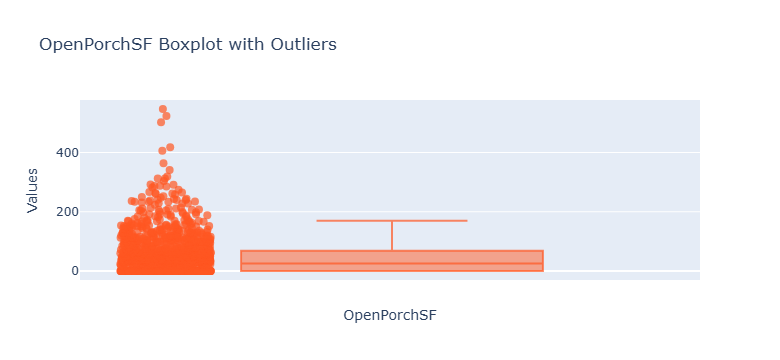

In [17]:
import plotly.express as px

# Loop through all numeric columns and create an interactive boxplot for each
for col in df.select_dtypes(include=['number']).columns:
    fig = px.box(df, y=col, points="all", title=f'{col} Boxplot with Outliers')
    fig.update_traces(marker=dict(color='rgba(255, 87, 34, 0.7)', size=8))  # Customize outlier markers
    fig.update_layout(
        xaxis_title=col,
        yaxis_title="Values",
    )
    fig.show()

## Skewness Test

In [9]:
df.select_dtypes(include='number').skew().sort_values(ascending=False)

MiscVal            24.476794
PoolArea           14.828374
LotArea            12.207688
3SsnPorch          10.304342
LowQualFinSF        9.011341
KitchenAbvGr        4.488397
BsmtFinSF2          4.255261
ScreenPorch         4.122214
BsmtHalfBath        4.103403
EnclosedPorch       3.089872
MasVnrArea          2.676412
LotFrontage         2.384950
OpenPorchSF         2.364342
SalePrice           1.882876
BsmtFinSF1          1.685503
WoodDeckSF          1.541376
TotalBsmtSF         1.524255
MSSubClass          1.407657
1stFlrSF            1.376757
GrLivArea           1.366560
BsmtUnfSF           0.920268
2ndFlrSF            0.813030
OverallCond         0.693067
TotRmsAbvGrd        0.676341
HalfBath            0.675897
Fireplaces          0.649565
HouseAge            0.613461
BsmtFullBath        0.596067
YearsSinceRemod     0.503562
OverallQual         0.216944
BedroomAbvGr        0.211790
GarageArea          0.179981
FullBath            0.036562
TimeIndex           0.005032
Id            

### Highly skewed

We see many variables with many 0s (absence of criteria), we transform them into a binary variable then, and keep the continious variable log if it has enough variance. If the variable hasn't enougn variance we drop it

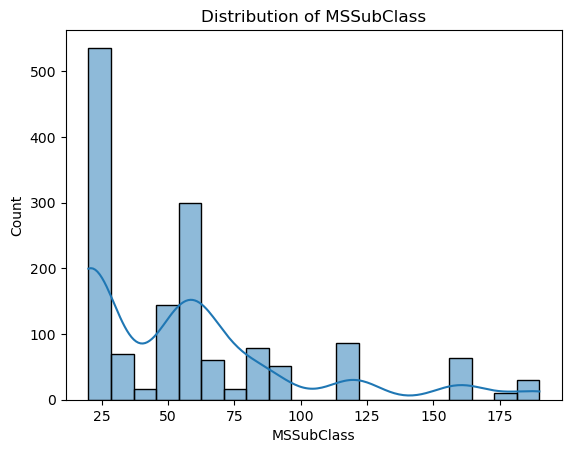

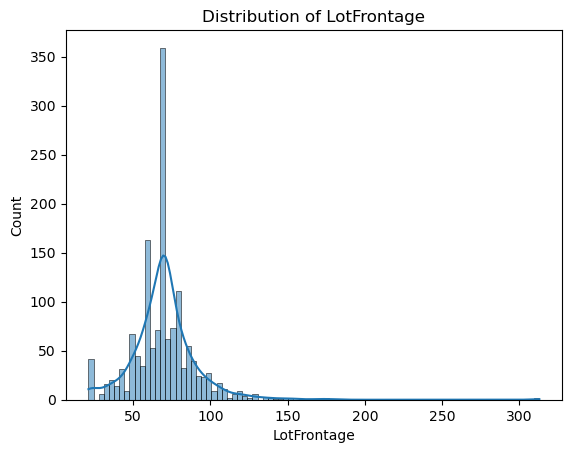

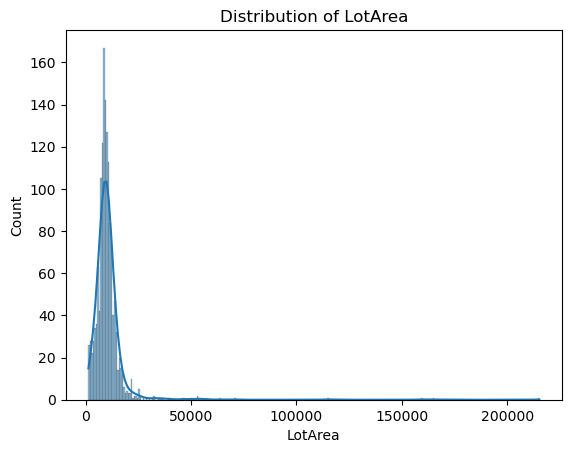

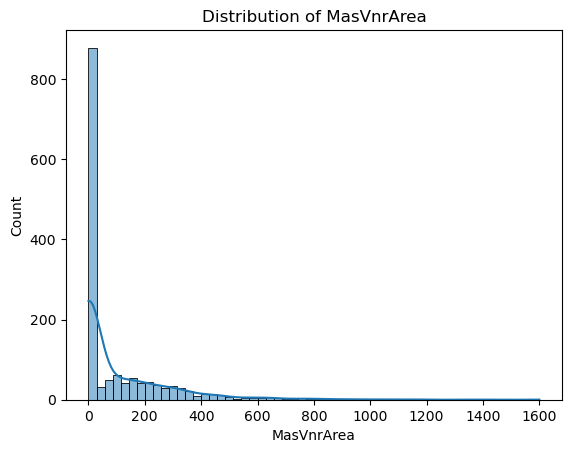

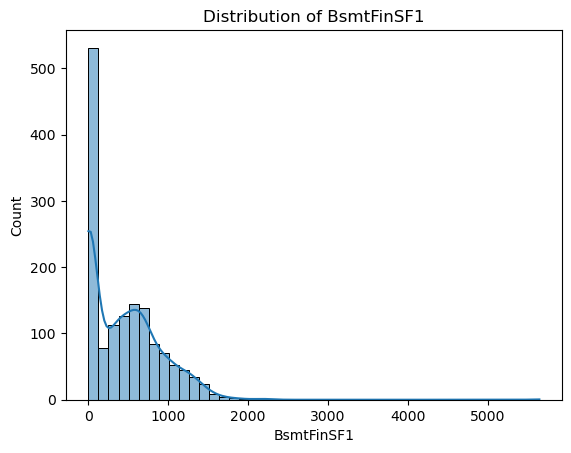

...

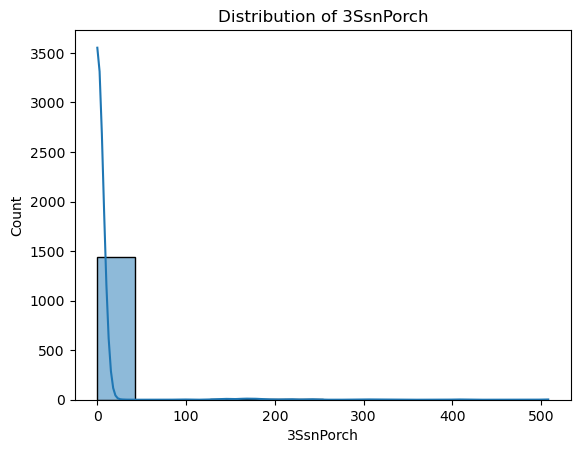

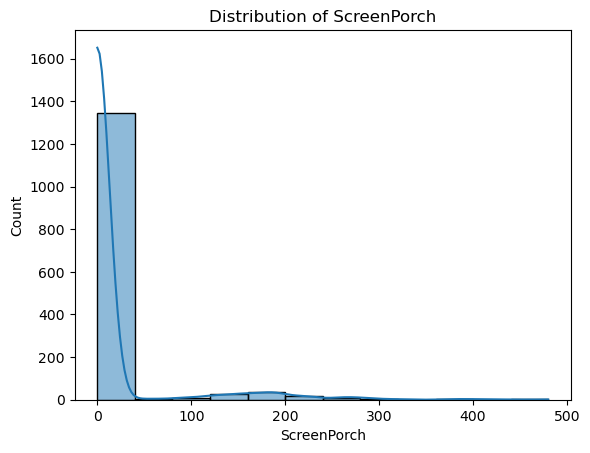

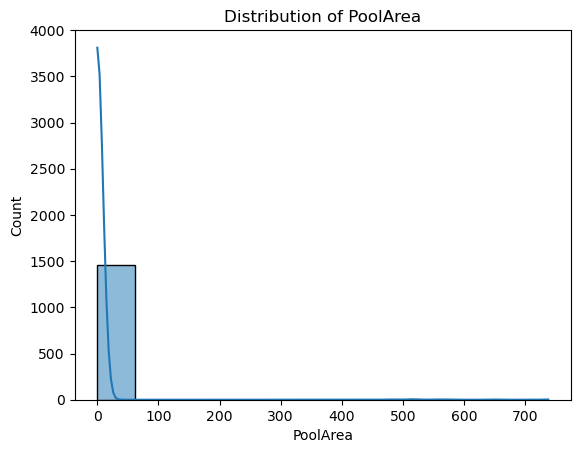

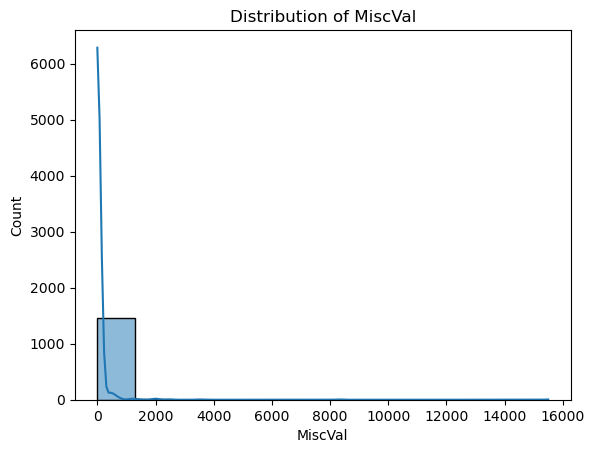

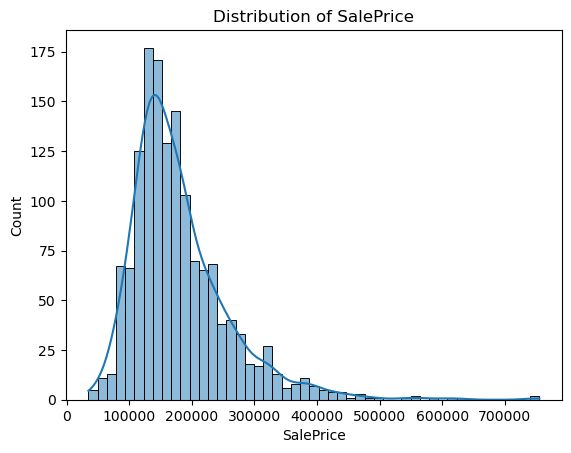

In [10]:
# Compute skewness of numeric columns
skewness = df.select_dtypes(include='number').skew()

# Select columns with high skew
skewed_cols = skewness[abs(skewness) > 0.75].index.tolist()

import seaborn as sns
import matplotlib.pyplot as plt

for col in skewed_cols:
    sns.histplot(df[col], kde=True)
    plt.title(f'Distribution of {col}')
    plt.show()

### Variable variance

In [11]:
for col in ['LowQualFinSF', 'BsmtHalfBath', 'KitchenAbvGr', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea',
 'MiscVal']:
    print(f"\nValue counts for '{col}':")
    print(df[col].value_counts().sort_index())


Value counts for 'LowQualFinSF':
LowQualFinSF
0      1434
53        1
80        3
120       1
144       1
156       1
205       1
232       1
234       1
360       2
371       1
384       1
390       1
392       1
397       1
420       1
473       1
479       1
481       1
513       1
514       1
515       1
528       1
572       1
Name: count, dtype: int64

Value counts for 'BsmtHalfBath':
BsmtHalfBath
0    1378
1      80
2       2
Name: count, dtype: int64

Value counts for 'KitchenAbvGr':
KitchenAbvGr
0       1
1    1392
2      65
3       2
Name: count, dtype: int64

Value counts for 'EnclosedPorch':
EnclosedPorch
0      1252
19        1
20        1
24        1
30        1
       ... 
301       1
318       1
330       1
386       1
552       1
Name: count, Length: 120, dtype: int64

Value counts for '3SsnPorch':
3SsnPorch
0      1436
23        1
96        1
130       1
140       1
144       2
153       1
162       1
168       3
180       2
182       1
196       1
216       2
238   

## Correlation

Des variables cont très corrélées (risque de multicolinéarité dans les modèles linéaires et de perte de variables explicatives dans les modèles de boosting)

In [13]:
def cramers_v(x, y):
    confusion_matrix = pd.crosstab(x, y)
    chi2, _, _, _ = chi2_contingency(confusion_matrix)
    n = confusion_matrix.sum().sum()
    phi2 = chi2 / n
    r, k = confusion_matrix.shape
    return np.sqrt(phi2 / min(k-1, r-1))

# Example usage:
cramers_v(df['Exterior1st'], df['Exterior2nd'])

0.7620101123416536

bonne correlation de certaines variables avec SalePrice

In [16]:
target_col = 'SalePrice'

# Select numeric columns
quantitative_vars = df.select_dtypes(include='number')

# Compute Pearson correlations with target
correlations = quantitative_vars.corr()[target_col].sort_values(ascending=False)

# Drop self-correlation (Price vs Price = 1)
correlations = correlations.drop(labels=[target_col])

# Display result
print(correlations)

OverallQual        0.790982
GrLivArea          0.708624
GarageCars         0.640409
GarageArea         0.623431
TotalBsmtSF        0.613581
1stFlrSF           0.605852
FullBath           0.560664
TotRmsAbvGrd       0.533723
MasVnrArea         0.475241
GarageYrBlt        0.470177
Fireplaces         0.466929
BsmtFinSF1         0.386420
LotFrontage        0.334901
WoodDeckSF         0.324413
2ndFlrSF           0.319334
OpenPorchSF        0.315856
HalfBath           0.284108
LotArea            0.263843
BsmtFullBath       0.227122
BsmtUnfSF          0.214479
BedroomAbvGr       0.168213
ScreenPorch        0.111447
PoolArea           0.092404
3SsnPorch          0.044584
BsmtFinSF2        -0.011378
BsmtHalfBath      -0.016844
MiscVal           -0.021190
TimeIndex         -0.021267
Id                -0.021917
LowQualFinSF      -0.025606
OverallCond       -0.077856
MSSubClass        -0.084284
EnclosedPorch     -0.128578
KitchenAbvGr      -0.135907
YearsSinceRemod   -0.507101
HouseAge          -0

## zoom on some variables

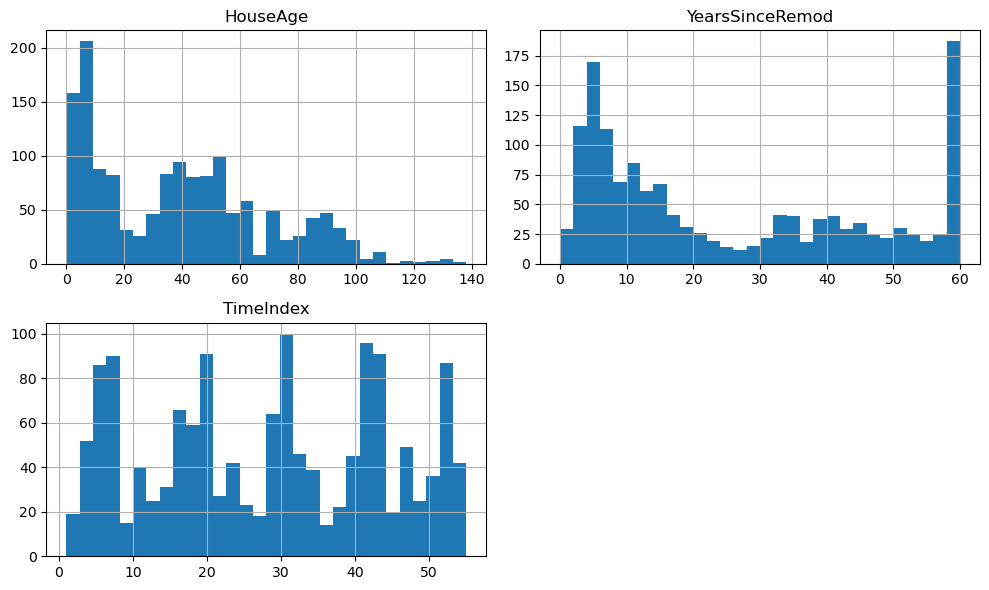

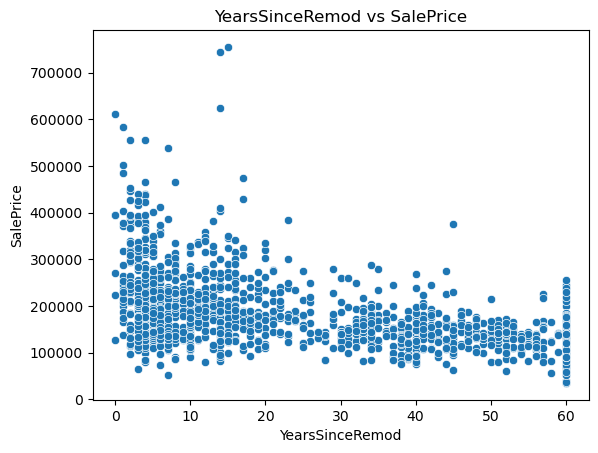

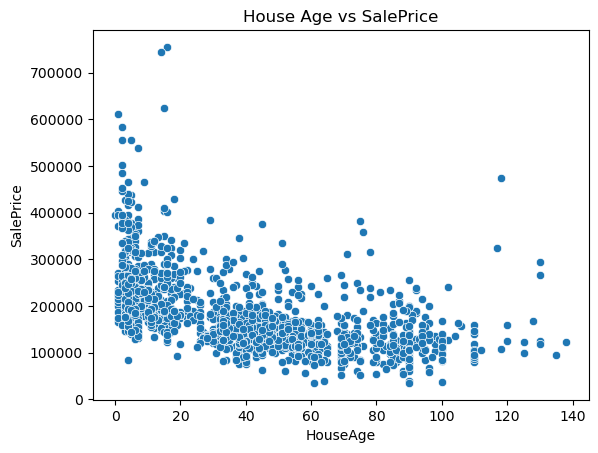

In [14]:
import matplotlib.pyplot as plt

df[['HouseAge', 'YearsSinceRemod', 'TimeIndex']].hist(bins=30, figsize=(10, 6))
plt.tight_layout()
plt.show()

## House age variable

#, 'TimeIndex' periodical not correlated sales price
sns.scatterplot(x='YearsSinceRemod', y='SalePrice', data=df)
plt.title("YearsSinceRemod vs SalePrice")
plt.show()

sns.scatterplot(x='HouseAge', y='SalePrice', data=df)
plt.title("House Age vs SalePrice")
plt.show()

Histogram Observations
HouseAge:

Bimodal distribution with many newer houses (0–20 years) and some spikes around 40–60 and beyond.

Long tail up to 140 (could contain some outliers).

YearsSinceRemod:

Strong skew toward 0–10 years.

Sharp peak at the right (~60), likely indicating houses never remodeled since being built a long time ago (a binary variable should be considered).

TimeIndex:

Uniform repeating pattern (sales cycles). Distribution looks regular and cyclical: May be useful if seasonality matters(modeling time trends or having lots of sales data). We exclud it in our analysis

## Relationships

We have some good linear relationships, but an outlier treatment is issentiel for some to come out

In [18]:
sns.pairplot(df)